# Generating CelebFaces (CelebA)

In this project we will generate images using:
* Variational Autoencoder (VAE)
* Generative Adversarial Network (GAN)
* Trained GAN's from Tensorflow HUB 

For our custom models we will use CelebFaces Attributes (CelebA) Dataset from https://www.kaggle.com/jessicali9530/celeba-dataset.

This dataset includes:
* 202 599 face images (178x218) of various celebrities.
* 40 binary attribute annotations per image. "1" represents positive while "-1" represents negative.

 

## Imports & Data Download

In [0]:
try:
    %tensorflow_version 2.x
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)

except:
    pass

In [0]:
!pip install -q -U toai

In [0]:
from toai.imports import *
import tensorflow as tf
from tensorflow import keras
import tensorflow_hub as hub
import os

In [0]:
print(__import__("toai").__version__)
print(__import__("tensorflow").__version__)

0.3.9
2.1.0-rc1


In [0]:
DATA_DIR = Path('data/celeba')

In [0]:
DATA_DIR.mkdir(parents=True, exist_ok=True)

In [0]:
TEMP_DIR = Path('./gdrive/My Drive/15_GAN_Celeba/temp/celeba')

In [0]:
def setup_kaggle():
    !rm -rf /root/.kaggle
    x = !ls kaggle.json
    assert x == ['kaggle.json'], 'Upload kaggle.json'
    !mkdir /root/.kaggle
    !mv kaggle.json /root/.kaggle
    !chmod 600 /root/.kaggle/kaggle.json
    
setup_kaggle()

In [0]:
DOWNLOAD_DATA = True

if DOWNLOAD_DATA:
    !kaggle datasets download -q -d jessicali9530/celeba-dataset --unzip -p {str(DATA_DIR)}

In [0]:
plt.show([1, 1])
%matplotlib inline

## EDA

In [0]:
def from_subfolders(path: Union[Path, str]):
        path = Path(path)
        paths = []
        for image_path in os.listdir(path):
            paths.append(str(path / image_path))

        return np.asarray(sorted(paths))

In [0]:
raw_img = from_subfolders(DATA_DIR /'img_align_celeba/img_align_celeba')

In [0]:
len(from_subfolders(DATA_DIR /'img_align_celeba/img_align_celeba'))

202599

In [0]:
def plot_images(images: List[np.ndarray], n_columns, n_rows):
    f,ax = plt.subplots(n_rows,n_columns, figsize=(3 * n_columns, 3 * n_rows))
    for i in range(n_columns*n_rows):
        rand_int = np.random.randint(len(images))
        ax[i // n_columns, i % n_columns].imshow(plt.imread(images[rand_int]))
        ax[i // n_columns, i % n_columns].axis('off')
        ax[i // n_columns, i % n_columns].set_title(os.path.basename(images[rand_int]))

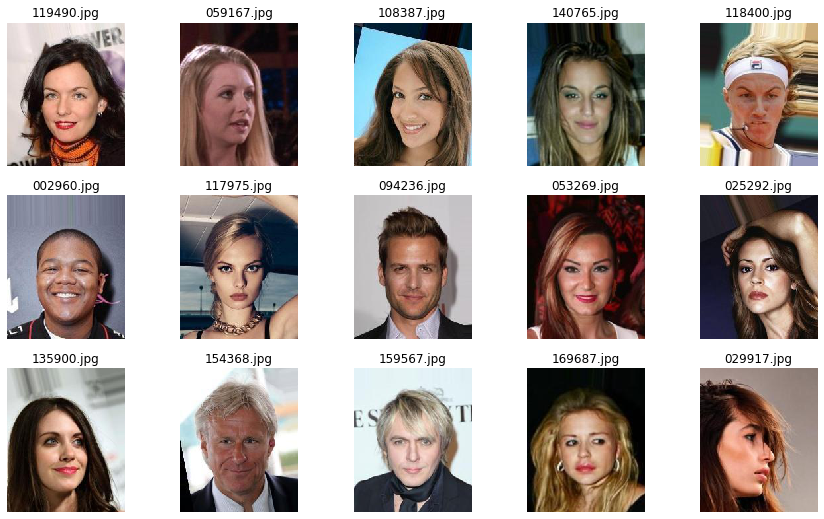

In [0]:
# Plotting random images
plot_images(raw_img, 5, 3)

In [0]:
# Exploring dataset of attributes
list_attr = pd.read_csv(DATA_DIR/'list_attr_celeba.csv')

In [0]:
list_attr.head().T

,0,1,2,3,4
image_id,000001.jpg,000002.jpg,000003.jpg,000004.jpg,000005.jpg
5_o_Clock_Shadow,-1,-1,-1,-1,-1
Arched_Eyebrows,1,-1,-1,-1,1
Attractive,1,-1,-1,1,1
Bags_Under_Eyes,-1,1,-1,-1,-1
Bald,-1,-1,-1,-1,-1
Bangs,-1,-1,-1,-1,-1
Big_Lips,-1,-1,1,-1,1
Big_Nose,-1,1,-1,-1,-1
Black_Hair,-1,-1,-1,-1,-1


In [0]:
list_attr.describe().T

,count,mean,std,min,25%,50%,75%,max
5_o_Clock_Shadow,202599.0,-0.777728,0.628602,-1.0,-1.0,-1.0,-1.0,1.0
Arched_Eyebrows,202599.0,-0.466039,0.884766,-1.0,-1.0,-1.0,1.0,1.0
Attractive,202599.0,0.025010,0.999690,-1.0,-1.0,1.0,1.0,1.0
Bags_Under_Eyes,202599.0,-0.590857,0.806778,-1.0,-1.0,-1.0,-1.0,1.0
Bald,202599.0,-0.955113,0.296241,-1.0,-1.0,-1.0,-1.0,1.0
Bangs,202599.0,-0.696849,0.717219,-1.0,-1.0,-1.0,-1.0,1.0
Big_Lips,202599.0,-0.518408,0.855135,-1.0,-1.0,-1.0,-1.0,1.0
Big_Nose,202599.0,-0.530935,0.847414,-1.0,-1.0,-1.0,-1.0,1.0
Black_Hair,202599.0,-0.521498,0.853255,-1.0,-1.0,-1.0,-1.0,1.0
Blond_Hair,202599.0,-0.704016,0.710186,-1.0,-1.0,-1.0,-1.0,1.0


In [0]:
list_attr.shape

(202599, 41)

In [0]:
list_attr.columns

Index(['image_id', '5_o_Clock_Shadow', 'Arched_Eyebrows', 'Attractive',
       'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose',
       'Black_Hair', 'Blond_Hair', 'Blurry', 'Brown_Hair', 'Bushy_Eyebrows',
       'Chubby', 'Double_Chin', 'Eyeglasses', 'Goatee', 'Gray_Hair',
       'Heavy_Makeup', 'High_Cheekbones', 'Male', 'Mouth_Slightly_Open',
       'Mustache', 'Narrow_Eyes', 'No_Beard', 'Oval_Face', 'Pale_Skin',
       'Pointy_Nose', 'Receding_Hairline', 'Rosy_Cheeks', 'Sideburns',
       'Smiling', 'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings',
       'Wearing_Hat', 'Wearing_Lipstick', 'Wearing_Necklace',
       'Wearing_Necktie', 'Young'],
      dtype='object')

In [0]:
def plot_attr(list_attr_a, n_columns, n_rows):
    f,ax = plt.subplots(n_rows,n_columns, figsize=(4 * n_columns, 4 * n_rows))
    for i, y in enumerate(list(list_attr_a.columns[1:])):
        sns.countplot(x=y, data=list_attr_a, ax=ax[i // n_columns, i % n_columns])
    plt.subplots_adjust(wspace=0.4, hspace=0.4)


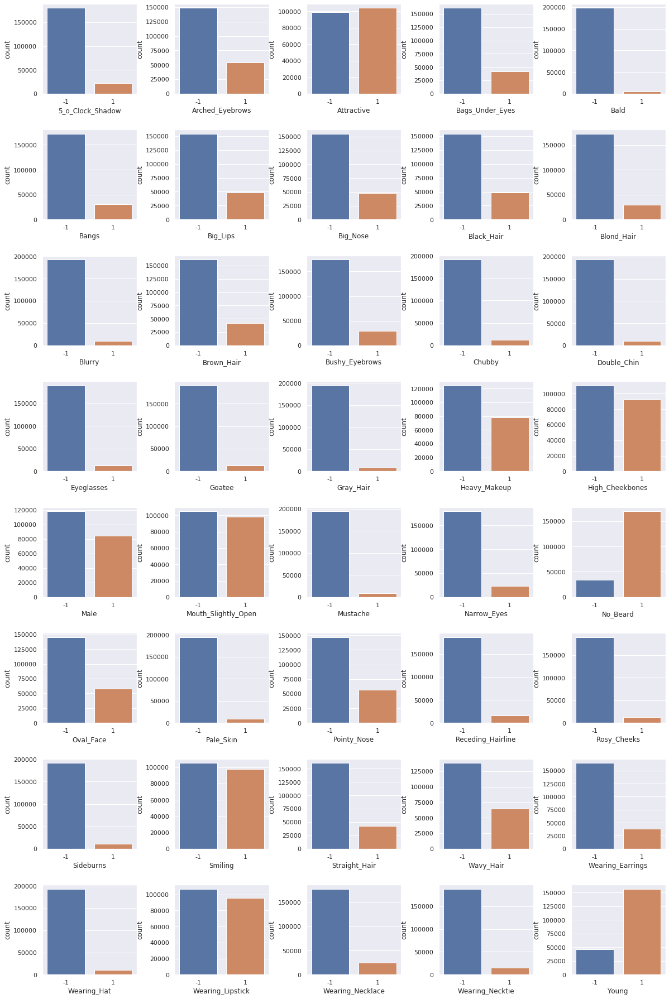

In [0]:
# Number of images by attribute - "1" is positive, "-1" is negative.
plot_attr(list_attr, 5, 8)

In [0]:
id_collumn = 'image_id'

In [0]:
def plot_img_by_feat(id_collumn, list_attr_a, n_columns, n_rows):
f,ax = plt.subplots(n_rows,n_columns, figsize=(4 * n_columns, 4 * n_rows))   
for i, y in enumerate(list(list_attr_a.columns[1:])):
    feat = list_attr_a[list_attr_a[y] == 1]
    rand_int = np.random.randint(len(feat))
    image_id = feat[id_collumn].iloc[rand_int]
    img = plt.imread(str(image_src / image_id))
    ax[i // n_columns, i % n_columns].imshow(img)
    ax[i // n_columns, i % n_columns].set_title(y)
    ax[i // n_columns, i % n_columns].axis('off')

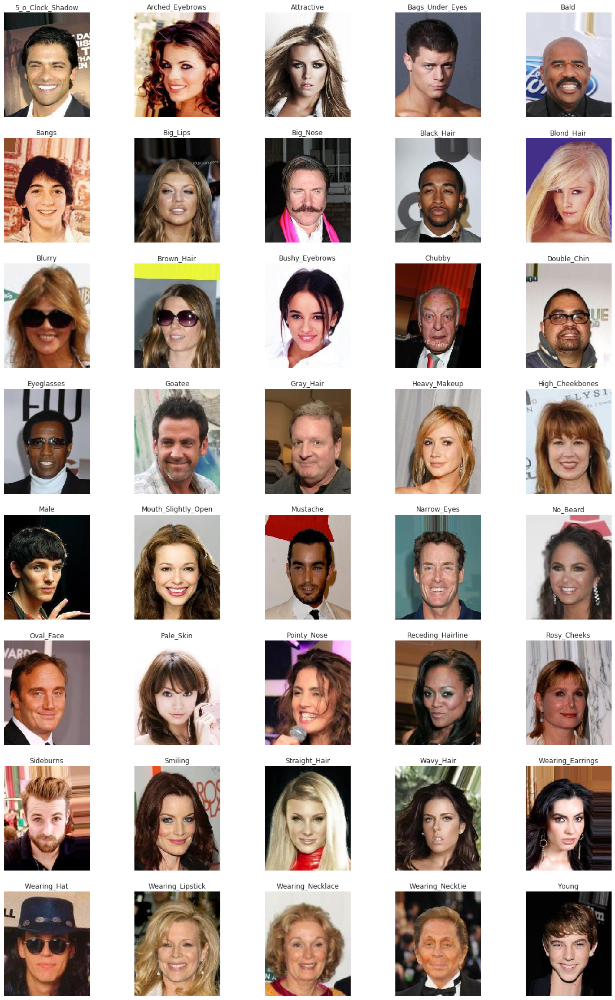

In [0]:
# Plotting image from each attribute
plot_img_by_feat(id_collumn, list_attr, 5, 8)

## Data Preparation

In [0]:
# crop images to 128X128
def get_cropped_images(images_paths, img_width = 178, img_height = 218, crop_width=128, crop_height=128):
    cropped = []
    for img_path in images_paths:
        im = Image.open(img_path)
        im = im.crop(((img_width - crop_width) // 2,
                         (img_height - crop_height) // 2,
                         (img_width + crop_width) // 2,
                         (img_height + crop_height) // 2))
        cropped.append(np.asarray(im).astype('float32')/255)
    cropped = np.asarray(cropped)

    return cropped

In [0]:
def plot_images_array(images, n_columns, n_rows):
    f,ax = plt.subplots(n_rows,n_columns, figsize=(2 * n_columns, 2 * n_rows))
    images = (images - images.min()) / (images.max() - images.min())

    for i in range(n_columns*n_rows):
        rand_int = np.random.randint(len(images))
        ax[i // n_columns, i % n_columns].imshow(images[rand_int])
        ax[i // n_columns, i % n_columns].axis('off')
    f.tight_layout()

In [0]:
# We will use 40000 images for VAE
N_IMAGES = 40000

In [0]:
new_data = get_cropped_images(raw_img[:N_IMAGES])

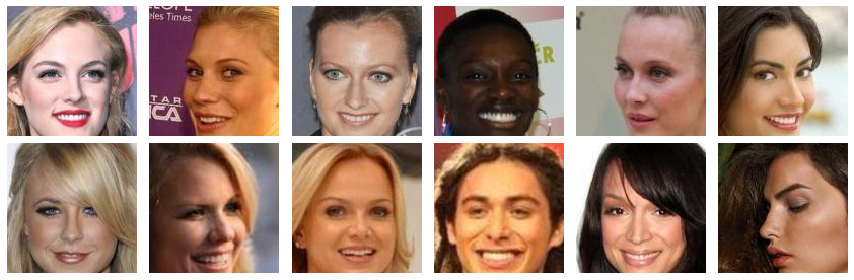

In [0]:
# Plotting cropped images
plot_images_array(new_data, 6, 2)

## Variational Autoencoder (VAE)

In [0]:
class Sampling(keras.layers.Layer):
    def call(self, inputs):
        mean, log_var = inputs
        return (
            keras.backend.random_normal(tf.shape(log_var))
            * keras.backend.exp(log_var / 2)
            + mean
        )

In [0]:
codings_size = 100

In [0]:
inputs = keras.layers.Input(shape=[128, 128,3])
x = inputs
x = keras.layers.Conv2D(
    64,
    kernel_size=3,
    strides=2,
    padding='same',
    activation=keras.activations.relu)(x)
x = keras.layers.Conv2D(
    64,
    kernel_size=3,
    strides=2,
    padding='same',
    activation=keras.activations.relu)(x)
x = keras.layers.Conv2D(
    128,
    kernel_size=3,
    strides=2,
    padding='same',
    activation=keras.activations.relu)(x)
x = keras.layers.Conv2D(
    128,
    kernel_size=3,
    strides=2,
    padding='same',
    activation=keras.activations.relu)(x)
x = keras.layers.Conv2D(
    128,
    kernel_size=3,
    strides=2,
    padding='same',
    activation=keras.activations.relu)(x)
shape = keras.backend.int_shape(x)
x = keras.layers.Flatten()(x)
x = keras.layers.Dense(256, activation=keras.activations.relu)(x)
x = keras.layers.Dense(128, activation=keras.activations.relu)(x)

codings_mean = keras.layers.Dense(codings_size)(x)
codings_log_var = keras.layers.Dense(codings_size)(x)
codings = Sampling()([codings_mean, codings_log_var])

encoder = keras.models.Model(
    inputs=[inputs], outputs=[codings_mean, codings_log_var, codings]
)

In [0]:
encoder.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 64, 64, 64)   1792        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 32, 32, 64)   36928       conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 16, 16, 128)  73856       conv2d_1[0][0]                   
______________________________________________________________________________________________

In [0]:
decoder_inputs = keras.layers.Input(shape=[codings_size])
x = decoder_inputs
x = keras.layers.Dense(4 * 4 * 128, activation=keras.activations.relu)(x)
x = keras.layers.Reshape((4,4,128))(x)
x = (keras.layers.Conv2DTranspose(
    64,
    kernel_size=3,
    strides=2,
    padding='same',
    activation=keras.activations.relu))(x)
x = (keras.layers.Conv2DTranspose(
    32,
    kernel_size=3,
    strides=2,
    padding='same',
    activation=keras.activations.relu))(x)
x = (keras.layers.Conv2DTranspose(
    32,
    kernel_size=3,
    strides=2,
    padding='same',
    activation=keras.activations.relu))(x)
x = (keras.layers.Conv2DTranspose(
    16,
    kernel_size=3,
    strides=2,
    padding='same',
    activation=keras.activations.relu))(x)
x = (keras.layers.Conv2DTranspose(
    8,
    kernel_size=3,
    strides=2,
    padding='same',
    activation=keras.activations.relu))(x)
outputs = keras.layers.Conv2DTranspose(
    3,
    kernel_size=3,
    padding='same',
    activation=keras.activations.sigmoid)(x)
decoder = keras.models.Model(decoder_inputs,outputs)


In [0]:
decoder.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 100)]             0         
_________________________________________________________________
dense_4 (Dense)              (None, 2048)              206848    
_________________________________________________________________
reshape (Reshape)            (None, 4, 4, 128)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 8, 8, 64)          73792     
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 16, 16, 32)        18464     
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 32, 32, 32)        9248      
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 64, 64, 16)        4624

In [0]:
_, _, codings = encoder(inputs)
reconstructions = decoder(codings)
vae = keras.models.Model(inputs=[inputs], outputs=[reconstructions])

In [0]:
vae.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 128, 128, 3)]     0         
_________________________________________________________________
model (Model)                [(None, 100), (None, 100) 990984    
_________________________________________________________________
model_1 (Model)              (None, 128, 128, 3)       314355    
Total params: 1,305,339
Trainable params: 1,305,339
Non-trainable params: 0
_________________________________________________________________


In [0]:
latent_loss = -0.5 * keras.backend.sum(
    1
    + codings_log_var
    - keras.backend.exp(codings_log_var)
    - keras.backend.square(codings_mean),
    axis=-1,
)

In [0]:
vae.add_loss(keras.backend.mean(latent_loss) / (128 * 128 * 3))

In [0]:
def rounded_accuracy(y_true, y_pred):
    return keras.metrics.binary_accuracy(tf.round(y_true), tf.round(y_pred))

In [0]:
vae.compile(
    loss=keras.losses.binary_crossentropy,
    optimizer=keras.optimizers.RMSprop(1e-3),
    metrics=[rounded_accuracy],
)

In [0]:
train_data = new_data[:-int(len(new_data) * 0.2)]

In [0]:
train_data.shape

(32000, 128, 128, 3)

In [0]:
validation_data = new_data[-int(len(new_data) * 0.2):]

In [0]:
validation_data.shape

(8000, 128, 128, 3)

In [0]:
def plot_reconstructions(
    model: keras.Model, images: np.ndarray = validation_data, n_images: int = 6
):
    reconstructions = model.predict(images[:n_images])
    fig = plt.figure(figsize=(n_images * 2, 4))
    for image_index in range(n_images):
        plt.subplot(2, n_images, 1 + image_index)
        plt.imshow(images[image_index])
        plt.axis('off')
        plt.subplot(2, n_images, 1 + n_images + image_index)

        plt.imshow(reconstructions[image_index])
        plt.axis('off')
        

In [0]:
def train_vae(model, total_epochs=25, n_cycles=5):
    start = time.time()
    for cycle  in range(n_cycles):
        print('Cycle {}/{}'.format(cycle + 1, n_cycles))
        vae.fit(
            train_data,
            train_data,
            epochs=int(total_epochs/n_cycles),
            batch_size=128,
            validation_data=[validation_data, validation_data],)
        plot_reconstructions(model)
        plt.show()
    print ('Total time for training {} epochs is {:.1f} min'.format(total_epochs, (time.time()-start)/60))


Cycle 1/5
Train on 32000 samples, validate on 8000 samples
Epoch 1/5
32000/32000 [==============================] - 29s 912us/sample - loss: 1.5477 - rounded_accuracy: 0.6785 - val_loss: 0.6108 - val_rounded_accuracy: 0.7546
Epoch 2/5
32000/32000 [==============================] - 26s 819us/sample - loss: 0.5920 - rounded_accuracy: 0.7949 - val_loss: 0.5757 - val_rounded_accuracy: 0.8297
Epoch 3/5
32000/32000 [==============================] - 26s 814us/sample - loss: 0.5753 - rounded_accuracy: 0.8253 - val_loss: 0.5704 - val_rounded_accuracy: 0.8409
Epoch 4/5
32000/32000 [==============================] - 26s 816us/sample - loss: 0.5683 - rounded_accuracy: 0.8378 - val_loss: 0.5665 - val_rounded_accuracy: 0.8320
Epoch 5/5
32000/32000 [==============================] - 26s 815us/sample - loss: 0.5636 - rounded_accuracy: 0.8462 - val_loss: 0.5604 - val_rounded_accuracy: 0.8544


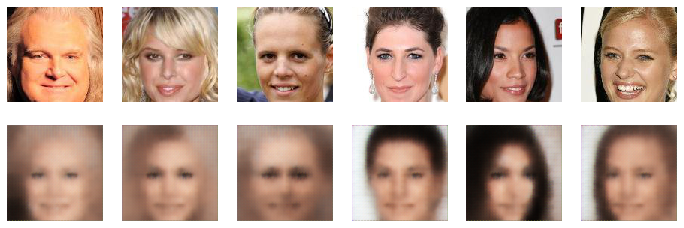

Cycle 2/5
Train on 32000 samples, validate on 8000 samples
Epoch 1/5
32000/32000 [==============================] - 26s 818us/sample - loss: 0.5601 - rounded_accuracy: 0.8524 - val_loss: 0.5609 - val_rounded_accuracy: 0.8589
Epoch 2/5
32000/32000 [==============================] - 26s 815us/sample - loss: 0.5578 - rounded_accuracy: 0.8571 - val_loss: 0.5594 - val_rounded_accuracy: 0.8546
Epoch 3/5
32000/32000 [==============================] - 26s 816us/sample - loss: 0.5559 - rounded_accuracy: 0.8605 - val_loss: 0.5568 - val_rounded_accuracy: 0.8555
Epoch 4/5
32000/32000 [==============================] - 26s 816us/sample - loss: 0.5544 - rounded_accuracy: 0.8634 - val_loss: 0.5537 - val_rounded_accuracy: 0.8702
Epoch 5/5
32000/32000 [==============================] - 26s 813us/sample - loss: 0.5530 - rounded_accuracy: 0.8661 - val_loss: 0.5514 - val_rounded_accuracy: 0.8702


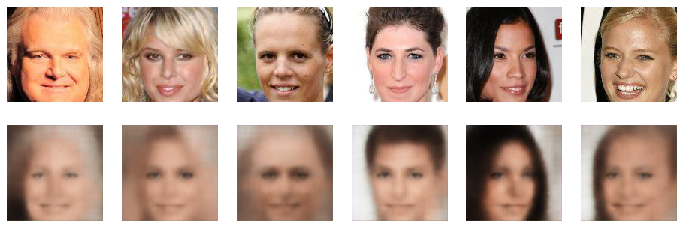

Cycle 3/5
Train on 32000 samples, validate on 8000 samples
Epoch 1/5
32000/32000 [==============================] - 26s 817us/sample - loss: 0.5519 - rounded_accuracy: 0.8680 - val_loss: 0.5551 - val_rounded_accuracy: 0.8578
Epoch 2/5
32000/32000 [==============================] - 26s 818us/sample - loss: 0.5509 - rounded_accuracy: 0.8698 - val_loss: 0.5496 - val_rounded_accuracy: 0.8732
Epoch 3/5
32000/32000 [==============================] - 26s 814us/sample - loss: 0.5500 - rounded_accuracy: 0.8717 - val_loss: 0.5511 - val_rounded_accuracy: 0.8691
Epoch 4/5
32000/32000 [==============================] - 26s 816us/sample - loss: 0.5493 - rounded_accuracy: 0.8731 - val_loss: 0.5479 - val_rounded_accuracy: 0.8769
Epoch 5/5
32000/32000 [==============================] - 26s 817us/sample - loss: 0.5484 - rounded_accuracy: 0.8750 - val_loss: 0.5527 - val_rounded_accuracy: 0.8602


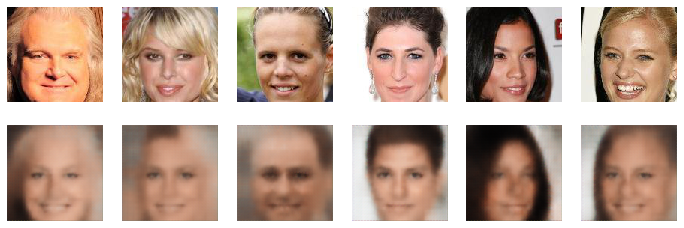

Cycle 4/5
Train on 32000 samples, validate on 8000 samples
Epoch 1/5
32000/32000 [==============================] - 26s 816us/sample - loss: 0.5475 - rounded_accuracy: 0.8768 - val_loss: 0.5461 - val_rounded_accuracy: 0.8827
Epoch 2/5
32000/32000 [==============================] - 26s 818us/sample - loss: 0.5468 - rounded_accuracy: 0.8783 - val_loss: 0.5477 - val_rounded_accuracy: 0.8768
Epoch 3/5
32000/32000 [==============================] - 26s 817us/sample - loss: 0.5460 - rounded_accuracy: 0.8797 - val_loss: 0.5483 - val_rounded_accuracy: 0.8797
Epoch 4/5
32000/32000 [==============================] - 26s 816us/sample - loss: 0.5454 - rounded_accuracy: 0.8809 - val_loss: 0.5546 - val_rounded_accuracy: 0.8450
Epoch 5/5
32000/32000 [==============================] - 26s 816us/sample - loss: 0.5448 - rounded_accuracy: 0.8820 - val_loss: 0.5443 - val_rounded_accuracy: 0.8858


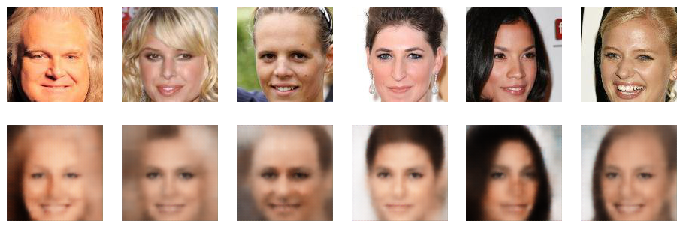

Cycle 5/5
Train on 32000 samples, validate on 8000 samples
Epoch 1/5
32000/32000 [==============================] - 26s 819us/sample - loss: 0.5443 - rounded_accuracy: 0.8832 - val_loss: 0.5465 - val_rounded_accuracy: 0.8777
Epoch 2/5
32000/32000 [==============================] - 26s 820us/sample - loss: 0.5437 - rounded_accuracy: 0.8841 - val_loss: 0.5487 - val_rounded_accuracy: 0.8789
Epoch 3/5
32000/32000 [==============================] - 26s 818us/sample - loss: 0.5432 - rounded_accuracy: 0.8849 - val_loss: 0.5429 - val_rounded_accuracy: 0.8885
Epoch 4/5
32000/32000 [==============================] - 26s 816us/sample - loss: 0.5428 - rounded_accuracy: 0.8858 - val_loss: 0.5440 - val_rounded_accuracy: 0.8856
Epoch 5/5
32000/32000 [==============================] - 26s 817us/sample - loss: 0.5424 - rounded_accuracy: 0.8865 - val_loss: 0.5453 - val_rounded_accuracy: 0.8796


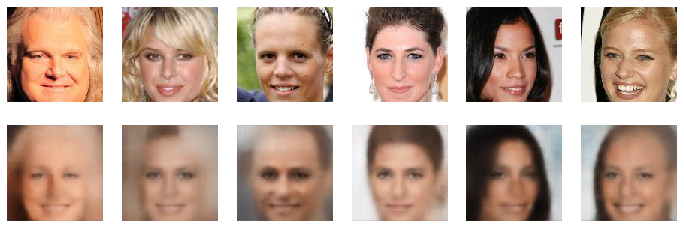

Total time for training 25 epochs is 11.0 min


In [0]:
train_vae(vae)

## Generative Adversarial Network (GAN)

### GAN 1

In [0]:
# For GAN version 1 we will use 10 000 images.
N_IMAGES = 10000

In [0]:
def make_generator():
    generator = keras.models.Sequential(
        [
            keras.layers.Dense(8 * 8 * 128, input_shape=[codings_size], activation=keras.activations.selu),
            keras.layers.Reshape([8, 8, 128]),
            keras.layers.BatchNormalization(),

            keras.layers.Conv2DTranspose(
                128,
                kernel_size=4,
                strides=2,
                padding='same',
                activation=keras.activations.selu,
            ),
            keras.layers.BatchNormalization(),

        keras.layers.Conv2DTranspose(
                128,
                kernel_size=4,
                strides=2,
                padding='same',
                activation=keras.activations.selu,
            ),
            keras.layers.BatchNormalization(),

        keras.layers.Conv2DTranspose(
                128,
                kernel_size=4,
                strides=2,
                padding='same',
                activation=keras.activations.selu,
            ),
            keras.layers.BatchNormalization(),

        keras.layers.Conv2DTranspose(
                128,
                kernel_size=4,
                strides=2,
                padding='same',
                activation=keras.activations.selu,
            ),
            keras.layers.BatchNormalization(),

            keras.layers.Conv2D(
                3,
                kernel_size=5,
                padding='same',
                activation=keras.activations.tanh,
            ),
        ]
    )
    return generator

In [0]:
generator_1 = make_generator()

In [0]:
generator_1.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 8192)              827392    
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 128)         0         
_________________________________________________________________
batch_normalization (BatchNo (None, 8, 8, 128)         512       
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 16, 16, 128)       262272    
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 32, 32, 128)       262272    
_________________________________________________________________
batch_normalization_2 (Batch (None, 32, 32, 128)       5

In [0]:
def make_discriminator():
    discriminator = keras.models.Sequential(
        [
            keras.layers.Conv2D(
                128,
                kernel_size=5,
                strides=2,
                padding='same',
                activation=keras.layers.LeakyReLU(0.2),
                input_shape=[128, 128, 3],
            ),
        keras.layers.Dropout(0.4),

            keras.layers.Conv2D(
                128,
                kernel_size=5,
                strides=2,
                padding='same',
                activation=keras.layers.LeakyReLU(0.2),
            ),
            keras.layers.Dropout(0.4),
        
                keras.layers.Conv2D(
                128,
                kernel_size=5,
                strides=2,
                padding='same',
                activation=keras.layers.LeakyReLU(0.2),
            ),
            keras.layers.Dropout(0.4),
        

            keras.layers.Conv2D(
                128,
                kernel_size=5,
                strides=2,
                padding='same',
                activation=keras.layers.LeakyReLU(0.2),
            ),
            keras.layers.Dropout(0.4),
            keras.layers.Flatten(),
            keras.layers.Dense(1, activation=keras.activations.sigmoid),
        ]
    )
    return discriminator

In [0]:
discriminator_1 = make_discriminator()

In [0]:
discriminator_1.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 64, 64, 128)       9728      
_________________________________________________________________
dropout (Dropout)            (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 32, 32, 128)       409728    
_________________________________________________________________
dropout_1 (Dropout)          (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 16, 16, 128)       409728    
_________________________________________________________________
dropout_2 (Dropout)          (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 8, 8, 128)        

In [0]:
gan = keras.models.Sequential([generator_1, discriminator_1])

In [0]:
discriminator_1.compile(
    loss=keras.losses.binary_crossentropy, optimizer=keras.optimizers.RMSprop(1e-3)
)
discriminator_1.trainable = False
gan.compile(
    loss=keras.losses.binary_crossentropy, optimizer=keras.optimizers.RMSprop(1e-3)
)

In [0]:
def train_gan(gan, dataset, batch_size, codings_size, n_epochs=1):
    generator, discriminator = gan.layers
    start = time.time()
    for epoch in range(n_epochs):
        start_1 = time.time()
        print('Epoch {}/{}'.format(epoch + 1, n_epochs))
        for train_batch in dataset:
            # phase 1 - training the discriminator
            noise = tf.random.normal(shape=[batch_size, codings_size])
            generated_images = generator(noise)
            fake_and_real_data = tf.concat([generated_images, train_batch], axis=0)
            fake_and_real_labels = tf.constant([[0.0]] * batch_size + [[1.0]] * batch_size)
            discriminator.trainable = True
            discriminator.train_on_batch(fake_and_real_data, fake_and_real_labels)
            # phase 2 - training the generator
            noise = tf.random.normal(shape=[batch_size, codings_size])
            noise_labels = tf.constant([[1.0]] * batch_size)
            discriminator.trainable = False
            gan.train_on_batch(noise, noise_labels)
        print ('Time for epoch {} is {:.1f} sec'.format(epoch + 1, time.time()-start_1))
        if (epoch+1) % 5 == 0:
            plot_images_array(generated_images.numpy(), 7, 2)
            plt.show()
    print ('Total time for training {} epochs is {:.1f} min'.format(n_epochs, (time.time()-start)/60))


In [0]:
batch_size = 64

In [0]:
codings_size = 100

In [0]:
gan_data = get_cropped_images(raw_img[:N_IMAGES])

In [0]:
dataset = (
    tf.data.Dataset.from_tensor_slices(gan_data * 2.0 - 1.0)
    .shuffle(N_IMAGES, reshuffle_each_iteration=True)
    .batch(batch_size, drop_remainder=True)
    .prefetch(1)
)

Epoch 1/25
Time for epoch 1 is 115.1 sec
Epoch 2/25
Time for epoch 2 is 111.2 sec
Epoch 3/25
Time for epoch 3 is 110.1 sec
Epoch 4/25
Time for epoch 4 is 110.1 sec
Epoch 5/25
Time for epoch 5 is 110.0 sec


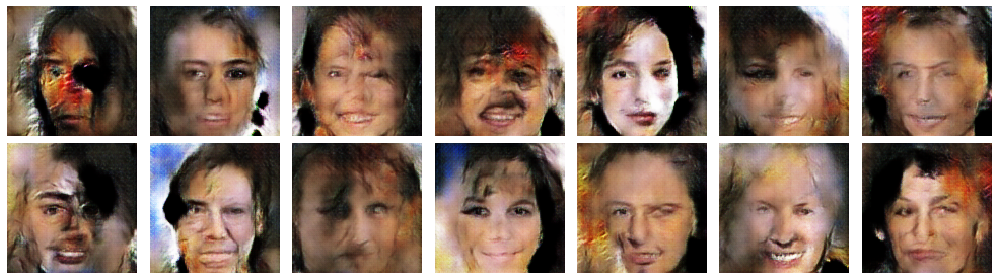

Epoch 6/25
Time for epoch 6 is 110.3 sec
Epoch 7/25
Time for epoch 7 is 110.1 sec
Epoch 8/25
Time for epoch 8 is 110.1 sec
Epoch 9/25
Time for epoch 9 is 110.1 sec
Epoch 10/25
Time for epoch 10 is 110.0 sec


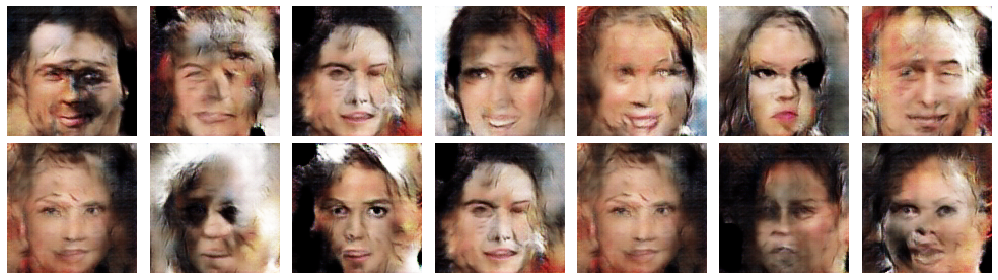

Epoch 11/25
Time for epoch 11 is 110.2 sec
Epoch 12/25
Time for epoch 12 is 110.0 sec
Epoch 13/25
Time for epoch 13 is 110.0 sec
Epoch 14/25
Time for epoch 14 is 109.9 sec
Epoch 15/25
Time for epoch 15 is 109.9 sec


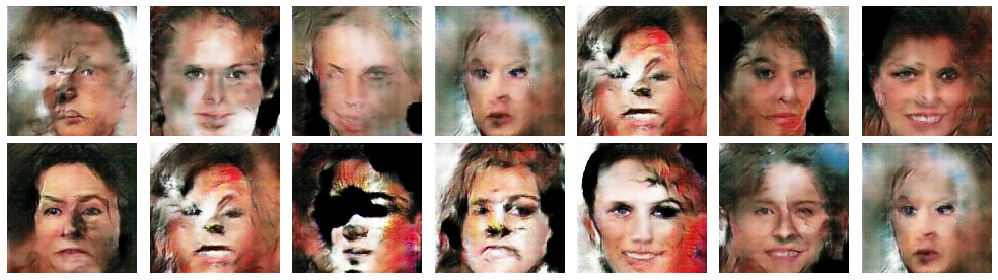

Epoch 16/25
Time for epoch 16 is 110.1 sec
Epoch 17/25
Time for epoch 17 is 110.0 sec
Epoch 18/25
Time for epoch 18 is 109.9 sec
Epoch 19/25
Time for epoch 19 is 109.9 sec
Epoch 20/25
Time for epoch 20 is 109.9 sec


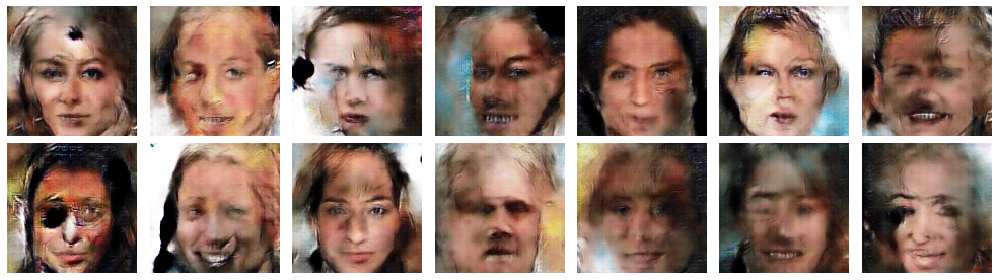

Epoch 21/25
Time for epoch 21 is 110.0 sec
Epoch 22/25
Time for epoch 22 is 109.8 sec
Epoch 23/25
Time for epoch 23 is 109.7 sec
Epoch 24/25
Time for epoch 24 is 109.9 sec
Epoch 25/25
Time for epoch 25 is 109.9 sec


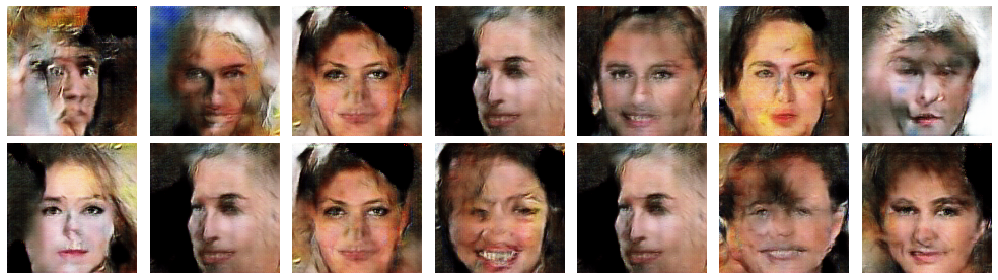

Total time for training 25 epochs is 46.0 min


In [0]:
train_gan(gan, dataset, batch_size, codings_size, n_epochs=25)

### GAN 2

In [0]:
# We will use more images - 40 000 instead of 10 000
N_IMAGES = 40000

In [0]:
generator_2 = make_generator()

In [0]:
discriminator_2 = make_discriminator()

In [0]:
gan = keras.models.Sequential([generator_2, discriminator_2])

In [0]:
discriminator_2.compile(
    loss=keras.losses.binary_crossentropy, optimizer=keras.optimizers.RMSprop(1e-3)
)
discriminator_2.trainable = False
gan.compile(
    loss=keras.losses.binary_crossentropy, optimizer=keras.optimizers.RMSprop(1e-3)
)

In [0]:
gan_data = get_cropped_images(raw_img[:N_IMAGES])

In [0]:
dataset = (
    tf.data.Dataset.from_tensor_slices(gan_data * 2.0 - 1.0)
    .shuffle(N_IMAGES, reshuffle_each_iteration=True)
    .batch(batch_size, drop_remainder=True)
    .prefetch(1)
)

Epoch 1/25
Time for epoch 1 is 249.2 sec
Epoch 2/25
Time for epoch 2 is 241.4 sec
Epoch 3/25
Time for epoch 3 is 241.6 sec
Epoch 4/25
Time for epoch 4 is 241.4 sec
Epoch 5/25
Time for epoch 5 is 242.4 sec


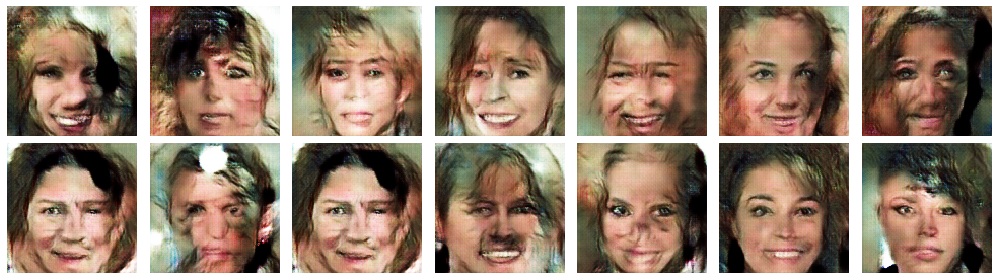

Epoch 6/25
Time for epoch 6 is 241.8 sec
Epoch 7/25
Time for epoch 7 is 242.2 sec
Epoch 8/25
Time for epoch 8 is 242.9 sec
Epoch 9/25
Time for epoch 9 is 242.2 sec
Epoch 10/25
Time for epoch 10 is 242.9 sec


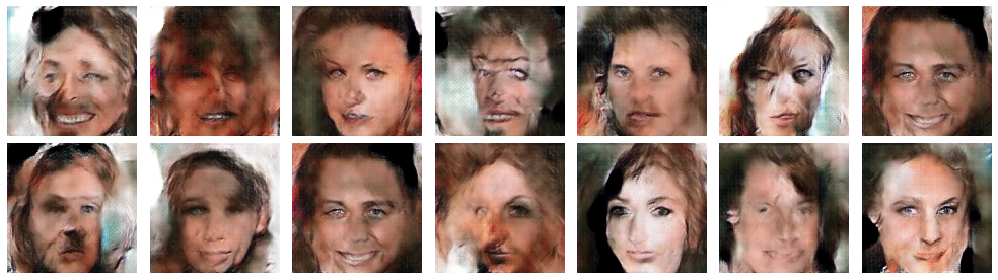

Epoch 11/25
Time for epoch 11 is 242.3 sec
Epoch 12/25
Time for epoch 12 is 241.8 sec
Epoch 13/25
Time for epoch 13 is 241.6 sec
Epoch 14/25
Time for epoch 14 is 241.8 sec
Epoch 15/25
Time for epoch 15 is 242.4 sec


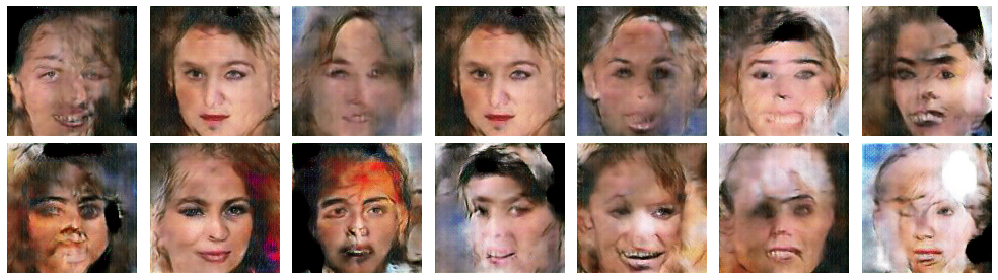

Epoch 16/25
Time for epoch 16 is 242.1 sec
Epoch 17/25
Time for epoch 17 is 242.0 sec
Epoch 18/25
Time for epoch 18 is 241.8 sec
Epoch 19/25
Time for epoch 19 is 242.3 sec
Epoch 20/25
Time for epoch 20 is 241.7 sec


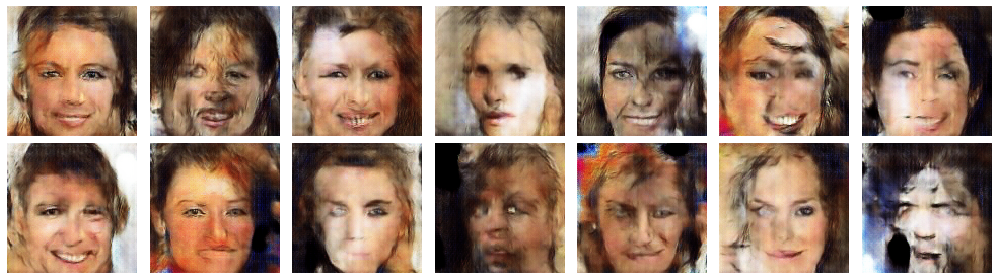

Epoch 21/25
Time for epoch 21 is 241.7 sec
Epoch 22/25
Time for epoch 22 is 241.4 sec
Epoch 23/25
Time for epoch 23 is 241.0 sec
Epoch 24/25
Time for epoch 24 is 241.4 sec
Epoch 25/25
Time for epoch 25 is 241.4 sec


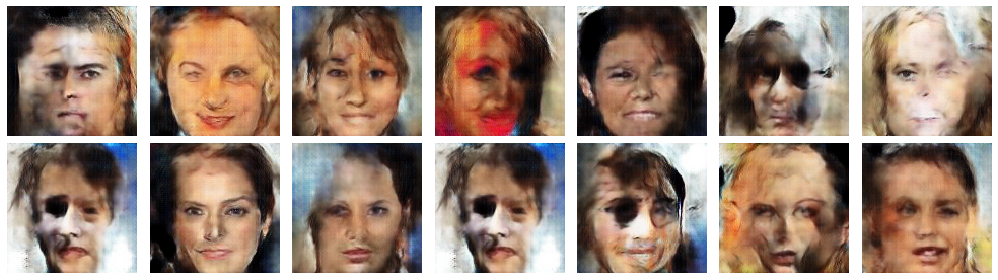

Total time for training 25 epochs is 101.0 min


In [0]:
train_gan(gan, dataset, batch_size, codings_size, n_epochs=25)

## Results

*Images, reconstructed by VAE (used 40 000 images to train).*
*Total time for training 25 epochs is 11.0 min*

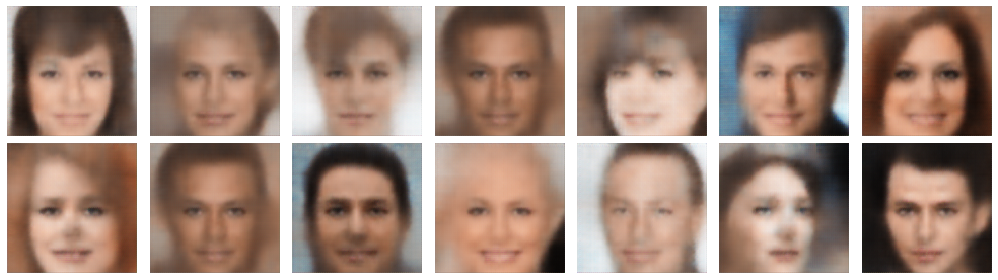

In [0]:
# Plotting random reconstructed validation data images 
plot_images_array(vae.predict(validation_data[:10000]), 7, 2)

*Images, generated by VAE (used 40 000 images to train).*
*Total time for training 25 epochs is 11.0 min*

In [0]:
gen = np.random.normal(size=(coding_sizes, 128, 128,3))

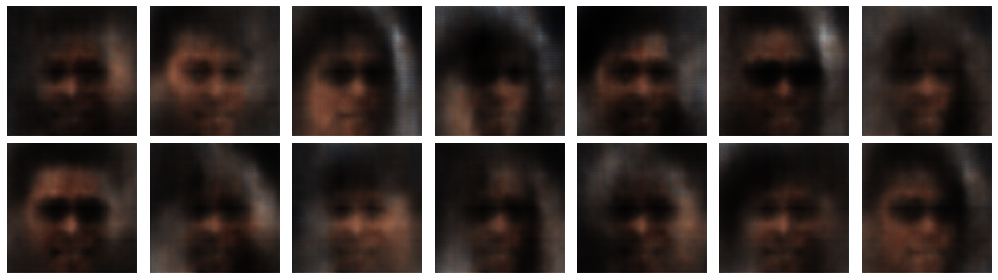

In [0]:
plot_images_array(vae.predict(gen), 7, 2)

*Images, generated by GAN version 1 (used 10 000 images to train).*
*Total time for training 25 epochs is 46.0 min*

In [0]:
generated_images_1 = generator_1(tf.random.normal(shape=[batch_size, codings_size]))

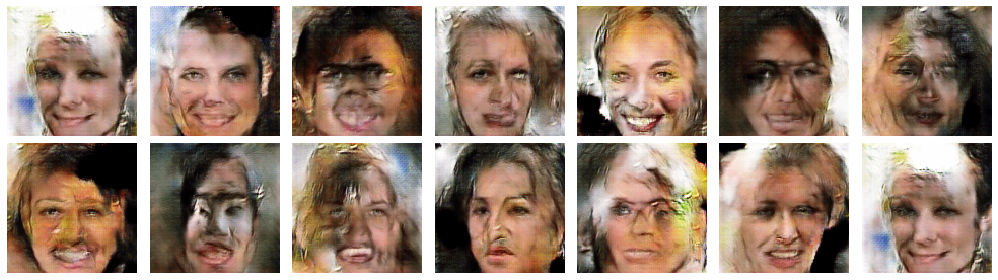

In [0]:
plot_images_array(generated_images_1, 7, 2)

*Images, generated by GAN version 2 (used 40 000 images to train).*
*Total time for training 25 epochs is 101.0 min*

In [0]:
generated_images_2 = generator_2(tf.random.normal(shape=[batch_size, codings_size]))

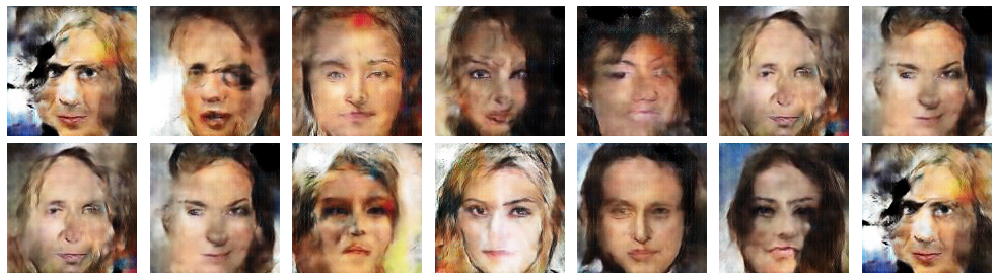

In [0]:
plot_images_array(generated_images_2, 7, 2)

## Trained GAN's from Tensorflow Hub

We will try to generate images using pretrained GAN models from TensorFlow Hub:
* Compare GAN
* BigGan-deep

Majority of code is taken from models' documentation.

In [0]:
try:
    %tensorflow_version 1.x
except:
    pass

### Compare GAN

***Code is taken from model documentation.***

#### ResNet19 trained on CelebA HQ (128x128)

Run the cells and select the GAN module to use from the table below.

In [0]:
#@title Imports, set up, and helper functions
from google.colab import output

tf.logging.set_verbosity(tf.logging.ERROR)

# Get the module metadata for the GANs as a pandas DataFrame.
module_metadata_dict = {
    'dataset': [
                'CelebA HQ (128x128)',
                'LSUN Bedroom',
                ],
    'penalty': [
                '-',
                '-'],
    'architecture': [
                        'ResNet19',
                        'ResNet19',
                        ],
    'beta1': [
                '0.375',
                '0.585',
                ],
    'beta2': [
                '0.998',
                '0.990',
                ],
    'module_url': [
                    'https://tfhub.dev/google/compare_gan/model_1_celebahq128_resnet19/1',
                    'https://tfhub.dev/google/compare_gan/model_3_lsun_bedroom_resnet19/1',
                    ],
    'disc_iters': [
                    1,
                    1,
                    ],
    'model': [
                'Non-saturating GAN',
                'Least-squares GAN',
                ],
    'inception_score': [
                        '2.38',
                        '4.23',
                        ],
    'disc_norm': [
                    'none',
                    'none',
                    ],
    'fid': [
            '34.29',
            '102.74',
            ],
    'ms_ssim_score': [
                        '0.32',
                        'N/A',
                        ],
    'learning_rate': [
                        '3.381e-05',
                        '3.220e-05',
                        ]
                        }
MODULE_METADATA = pd.DataFrame.from_dict(module_metadata_dict)

# To start, select the module with the lowest FID score.
MIN_FID_MODULE = MODULE_METADATA.loc[
    MODULE_METADATA['fid'].astype(float).idxmin()]

SELECTED_MODULE = MIN_FID_MODULE['module_url']
SELECTED_MODULE_DATASET = MIN_FID_MODULE['dataset']


# Display multiple images in the same figure.
def display_images(images, captions=None):
  batch_size, dim1, dim2, channels = images.shape
  num_horizontally = 8
  
  # Use a smaller figure size for the CIFAR10 images
  figsize = (20, 20) if dim1 > 32 else (10, 10)
  f, axes = plt.subplots(
      len(images) // num_horizontally, num_horizontally, figsize=figsize)
  for i in range(len(images)):
    axes[i // num_horizontally, i % num_horizontally].axis("off")
    if captions is not None:
      axes[i // num_horizontally, i % num_horizontally].text(0, -3, captions[i])
    axes[i // num_horizontally, i % num_horizontally].imshow(images[i])
  f.tight_layout()
  

# Show the HTML for the module table
class ShowModuleTable(object):
  def __init__(self, callback):
    self._callback = callback

  def _repr_html_(self):
    # Set up the template with some nice CSS.
    template = """
    <style>
       table {
         font-size: 15px;
         font-family: Inconsolata, monospace;
         border-collapse: collapse;
         border: 1px solid #444444;
       }
       th {
         font-size: 18px;
         background-color: #DDDDDD;
         border: 1px solid #AAAAAA;
         white-space: nowrap;
       }
       tr {
         cursor: pointer;
         white-space: nowrap;
       }
       td {
         padding: 6px 6px 6px 6px;
         border: 1px solid #AAAAAA;
       }
      .selected-row {
        font-weight: bold;
        background-color: #B0BED9;
      }
    </style>
    <table>"""
    
    # Set up the headers with nicely readable names
    table_headers = [
      ('dataset', 'Dataset'),
      ('architecture', 'Architecture'),
      ('fid', 'FID'),
      ('inception_score', 'IS'),
      ('ms_ssim_score', 'MS-SSIM'),
      ('model', 'Model'),
      ('learning_rate', 'Learning rate'),
      ('beta1', '&beta;<sub>1</sub>'),
      ('beta2', '&beta;<sub>2</sub>'),
      ('disc_iters', 'n<sub>disc</sub>'),
      ('disc_norm', 'Disc norm'),
      ('penalty', 'Penalty'),
      ('module_url', 'Module name'),
    ]
    header_template = "<tr>"
    for _, header_name in table_headers:
      header_template += "<th>" + header_name + "</th>"
    header_template += "</tr>"
    template += header_template
    
    for i, (_, row) in enumerate(MODULE_METADATA.iterrows()):
      uuid = "row-%s" % i
      
      # Reister the callback for every row.
      output.register_callback(uuid, self._callback)
      
      # By default select the module with the min FID.
      selected_class = ""
      if row['module_url'] == MIN_FID_MODULE['module_url']:
        selected_class = "class=\"selected-row\""

      # Get the metadata for each row.
      row_template = "<tr id=\"" + uuid + "\"" + selected_class + ">"
      for key, _ in table_headers:
        row_template += "<td>" + str(row[key]) + "</td>"
      row_template += "</tr>"
      template += row_template
      
    # Add the onclick handlers for the table rows.
    template += """
      </table>
      <script>"""
    
    for i, (_, row) in enumerate(MODULE_METADATA.iterrows()):
      uuid = "row-%s" % i
      m = row['module_url']
      d = row['dataset']
      template += """
        document.querySelector(\"#""" + uuid + """\").onclick = function() {
          google.colab.kernel.invokeFunction('""" + uuid + """', ['""" + m +"""', '""" + d + """'], {});
          var selected = document.getElementsByClassName('selected-row');
          for (var i = 0; i < selected.length; i++) {
            selected[i].classList.remove('selected-row');
          }
          this.classList.toggle("selected-row");
          e.preventDefault();
        };
        """
    template += """</script>"""
    return template


def set_selected_module(module_name, dataset):
  # Assign the selected module and dataset to the global variables
  global SELECTED_MODULE
  SELECTED_MODULE = module_name
  global SELECTED_MODULE_DATASET
  SELECTED_MODULE_DATASET = dataset

In [0]:
#@title Run this cell and select which GAN module to use below

ShowModuleTable(set_selected_module)

Dataset,Architecture,FID,IS,MS-SSIM,Model,Learning rate,β1,β2,ndisc,Disc norm,Penalty,Module name
CelebA HQ (128x128),ResNet19,34.29,2.38,0.32,Non-saturating GAN,3.381e-05,0.375,0.998,1,none,-,https://tfhub.dev/google/compare_gan/model_1_celebahq128_resnet19/1
LSUN Bedroom,ResNet19,102.74,4.23,N/A,Least-squares GAN,3.220e-05,0.585,0.990,1,none,-,https://tfhub.dev/google/compare_gan/model_3_lsun_bedroom_resnet19/1


Using module: "https://tfhub.dev/google/compare_gan/model_1_celebahq128_resnet19/1"
Generating images like dataset: "CelebA HQ (128x128)"


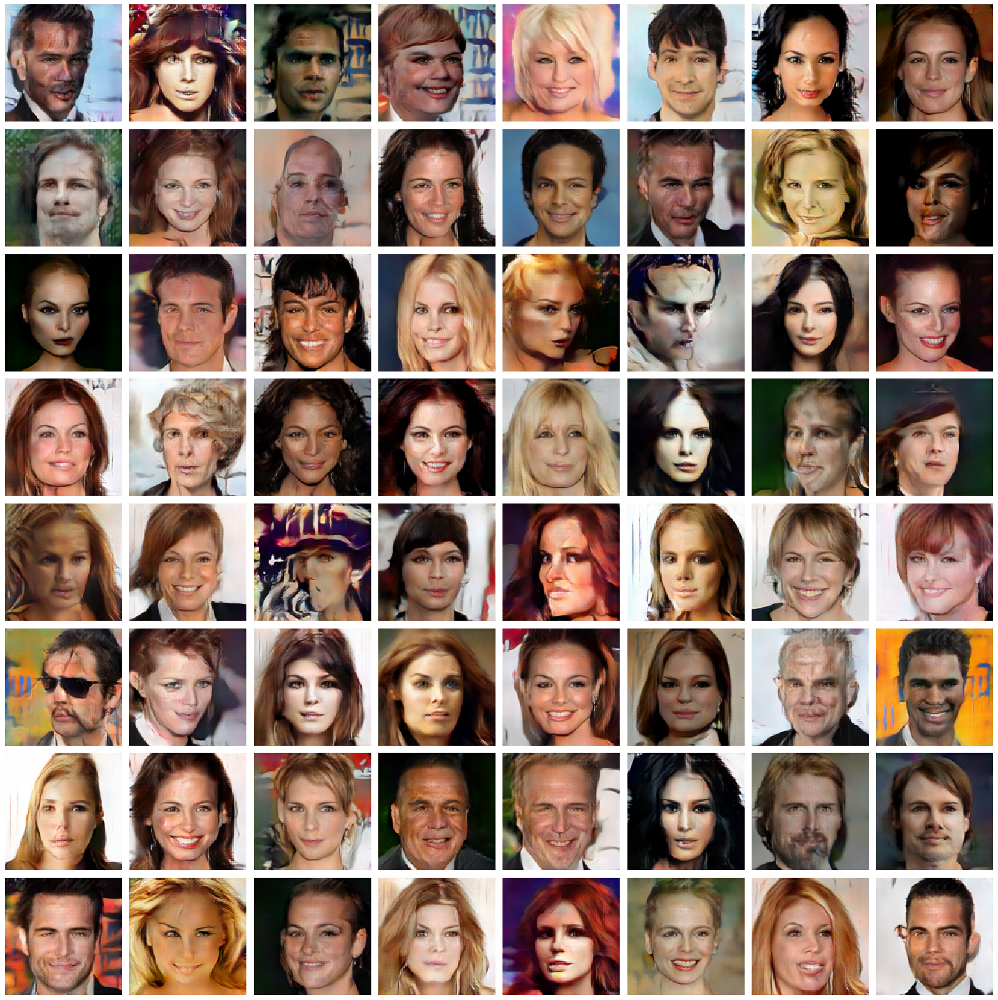

In [0]:
# Generate images from the selected module (/compare_gan/model_1_celebahq128_resnet19/1)
assert SELECTED_MODULE is not None and SELECTED_MODULE_DATASET is not None, \
  'You must run the above cell and select a module from the table to generate images.'

print('Using module: "%s"' % SELECTED_MODULE)
print('Generating images like dataset: "%s"' % SELECTED_MODULE_DATASET)

# The generator expects a batch of 64 vectors of size 128
batch_size = 64
z_dim = 128

with tf.Graph().as_default():
  # Load the selected module
  gan = hub.Module(SELECTED_MODULE)
  z_input = tf.placeholder(dtype=tf.float32, shape=(batch_size, z_dim))
  image_output = gan(z_input, signature="generator") 
  
  with tf.train.MonitoredSession() as session:
    # Generate 64 random vectors as input to the latent space to generate images
    z_values = np.random.uniform(-1, 1, size=(batch_size, z_dim))
    images = session.run(image_output, feed_dict={z_input: z_values})

    # View the resulting images
    display_images(images)

#### ResNet19 trained on LSUN Bedroom

Using module: "https://tfhub.dev/google/compare_gan/model_3_lsun_bedroom_resnet19/1"
Generating images like dataset: "LSUN Bedroom"


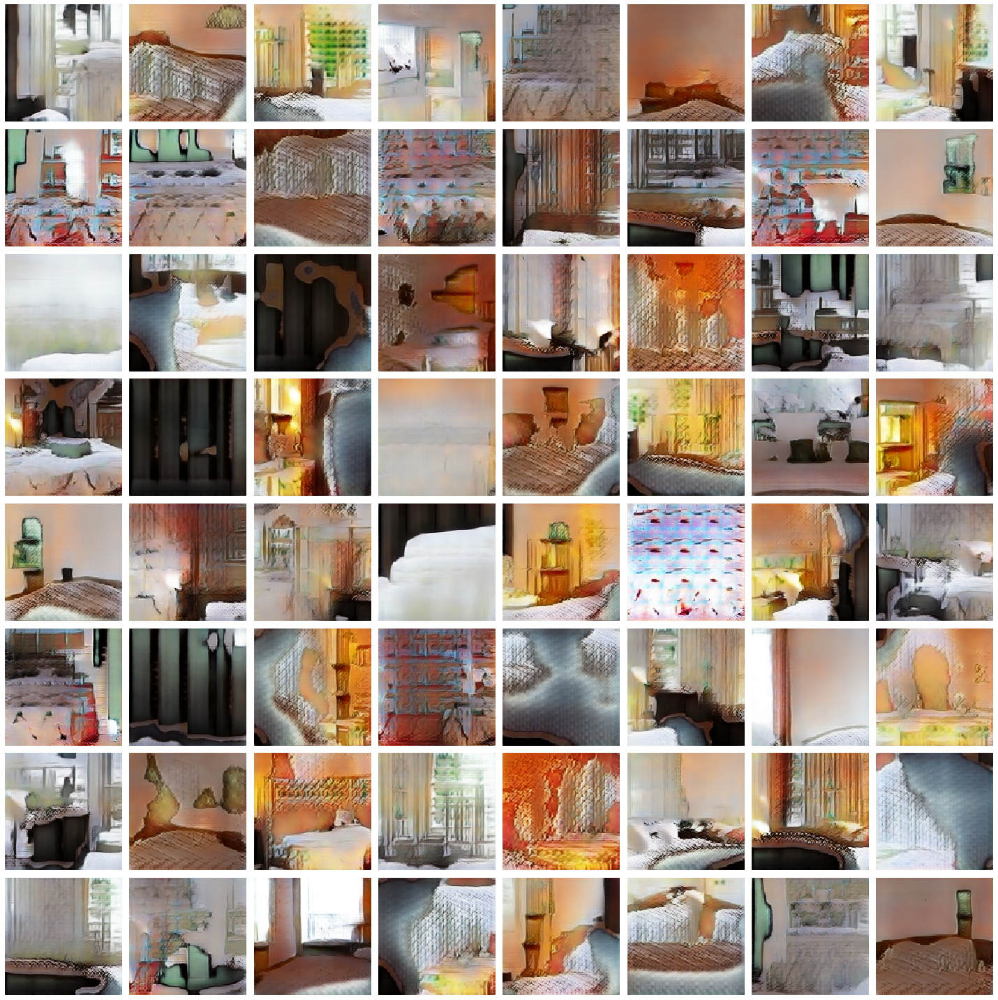

In [0]:
# Generate images from the selected module (/compare_gan/model_3_lsun_bedroom_resnet19/1)
assert SELECTED_MODULE is not None and SELECTED_MODULE_DATASET is not None, \
  'You must run the above cell and select a module from the table to generate images.'

print('Using module: "%s"' % SELECTED_MODULE)
print('Generating images like dataset: "%s"' % SELECTED_MODULE_DATASET)

# The generator expects a batch of 64 vectors of size 128
batch_size = 64
z_dim = 128

with tf.Graph().as_default():
  # Load the selected module
  gan = hub.Module(SELECTED_MODULE)
  z_input = tf.placeholder(dtype=tf.float32, shape=(batch_size, z_dim))
  image_output = gan(z_input, signature="generator") 
  
  with tf.train.MonitoredSession() as session:
    # Generate 64 random vectors as input to the latent space to generate images
    z_values = np.random.uniform(-1, 1, size=(batch_size, z_dim))
    images = session.run(image_output, feed_dict={z_input: z_values})

    # View the resulting images
    display_images(images)

### BigGAN-deep image generator trained on 128x128 ImageNet

In [0]:
# Code in this cell is taken from model documentation.

# Load BigGAN-deep 128 module.
module = hub.Module('https://tfhub.dev/deepmind/biggan-deep-128/1')

# Sample random noise (z) and ImageNet label (y) inputs.
batch_size = 64
truncation = 0.5  # scalar truncation value in [0.0, 1.0]
z = truncation * tf.random.truncated_normal([batch_size, 128])  # noise sample
y_index = tf.random.uniform([batch_size], maxval=1000, dtype=tf.int32)
y = tf.one_hot(y_index, 1000)  # one-hot ImageNet label

# Call BigGAN on a dict of the inputs to generate a batch of images with shape
# [64, 128, 128, 3] and range [-1, 1].
samples = module(dict(y=y, z=z, truncation=truncation))

In [0]:
initializer = tf.global_variables_initializer()
sess = tf.Session()
sess.run(initializer)

In [0]:
gen_images = samples.eval(session=sess)

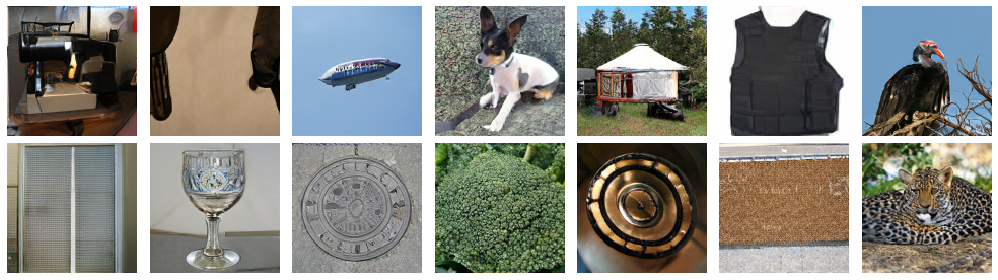

In [0]:
plot_images_array(gen_images, 7, 2)